<a href="https://colab.research.google.com/github/Jedi80/21-Projects-in-21-Days-Projects-AI-ML-and-Data-Science/blob/main/Project_17/17_Build_your_own_Intelligent_Image_Search_Engine.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Introduction and Environment Setup

The advent of powerful Large Language Models (LLMs) has fundamentally altered the landscape of artificial intelligence applications.

The primary interface for these models is natural language, making the skill of crafting effective inputs—a discipline known as **prompt engineering**—a critical component for developers and researchers.

Prompt engineering is not merely the act of asking a question; it is the science of designing and optimizing prompts to guide LLMs toward desired outcomes with precision, reliability, and efficiency.

As models grow in capability, the sophistication of interaction methods must evolve in parallel.

Simple instructions suffice for simple tasks, but unlocking the full potential for complex reasoning, persona adoption, and interaction with external systems requires a more advanced approach.

## Setup your free API Key using Google's AI Studio

https://aistudio.google.com/


### Install necessary libraries

In [ ]:
!pip install --upgrade --quiet langchain-google-genai

In [ ]:
import os
from google.colab import userdata
from langchain_google_genai import ChatGoogleGenerativeAI

# Access the API key from Colab Secrets
os.environ["GOOGLE_API_KEY"] = userdata.get("GOOGLE_API_KEY")

# Initialize the model
gemini_client = ChatGoogleGenerativeAI(model="gemini-2.5-flash")

# Now you can use the llm to interact with the model
response = gemini_client.invoke("""

## **1. Role (Persona)**

You are an expert NLP analyst specializing in sentiment interpretation. You have advanced experience evaluating emotional tone, contextual nuance, and linguistic subtleties across diverse text genres. You communicate clearly, concisely, and with analytical precision.

---

## **2. Context (Background Information)**

You will receive short or long pieces of user-generated text. These may include reviews, emails, comments, transcripts, social media posts, or general statements. The sentiment may be explicit, mixed, implicit, or context-dependent. The goal is to reliably classify sentiment and explain the reasoning behind the classification.

---

## **3. Task (Instruction/Directive)**

Analyze the sentiment of the given text. Determine whether it is **Positive**, **Negative**, **Neutral**, or **Mixed**. Provide a short justification grounded in specific textual evidence.

---

## **4. Examples (Few-Shot Samples)**

### **Example 1**

**Input:**
“I love the new update! The interface is clean and everything works smoothly.”

**Output:**

* **Sentiment:** Positive
* **Reasoning:** Expresses satisfaction (“love,” “clean,” “works smoothly”).

---

### **Example 2**

**Input:**
“This app keeps crashing. I can’t get anything done.”

**Output:**

* **Sentiment:** Negative
* **Reasoning:** Strong dissatisfaction (“keeps crashing,” “can’t get anything done”).

---

### **Example 3**

**Input:**
“The product is fine. Nothing special, but not bad either.”

**Output:**

* **Sentiment:** Neutral
* **Reasoning:** Balanced language without strong positive or negative statements.

---

### **Example 4**

**Input:**
“The service was great, but delivery took forever.”

**Output:**

* **Sentiment:** Mixed
* **Reasoning:** Contains both positive (“great”) and negative (“took forever”) aspects.

---

## **5. Constraints (Rules/Warnings)**

* Do **not** rewrite or correct the input text.
* Do **not** add details not present in the input.
* Keep reasoning brief (1–3 sentences).
* Maintain objective analytical tone.
* Output only what is requested—no extra commentary or disclaimers.

---

## **6. Output Format**

Respond **strictly** in the following JSON structure:

```json
{
  "sentiment": "<Positive|Negative|Neutral|Mixed>",
  "reasoning": "<short explanation referencing text>",
  "confidence": "<percentage from 0-100>"
}
```
Input: This class is amazing! The students are very interactive which helps the teacher!!

""")
print(response.content)

# The Anatomy of an Effective Prompt: A Unified Framework

A fundamental advancement in prompt engineering is the realization that a prompt is not a monolithic question but a structured document composed of distinct components.



- **Role (or Persona):** This component defines who the model should be. Assigning a role, such as "You are a senior technical support specialist," constrains the model's vast knowledge base, forcing it to filter its response through a specific lens of expertise, tone, and style. This dramatically improves the coherence and domain-specificity of the output.


- **Context (or Background Information):** This provides the necessary background for the task. It can include user history, product documentation, previous conversation turns, or any other data that informs the query. Providing rich context is essential for generating relevant and personalized responses.


- **Task (or Instruction/Directive):** This is the core of the prompt—a clear, specific, and unambiguous statement of the action the model should perform. The use of direct action verbs (e.g., "Analyze," "Summarize," "Generate," "Classify") is critical for clarity.


- **Examples (or Shots):** These are high-quality examples of the desired input-output pattern. They are the foundation of few-shot prompting and are one of the most powerful tools for controlling output format and style. By showing the model exactly what is expected, examples enable a form of in-context learning.


- **Constraints (or Rules/Warnings):** This component defines the boundaries for the response. It specifies what the model should not do, such as avoiding certain topics, adhering to a word count, or refraining from using technical jargon. These "guardrails" are crucial for safety and brand alignment.


- **Output Format (or Structure):** This explicitly defines the structure of the desired output, such as JSON, Markdown, or a bulleted list. Specifying the format is vital for applications that need to programmatically parse the model's response, as it ensures the output is machine-readable and consistent.

To help the model distinguish between these different components, it is a best practice to use clear delimiters. Structuring the prompt with markers like Markdown headers (e.g., `###Instruction###`).

# Let's talk about RAG, now

# Our Approach

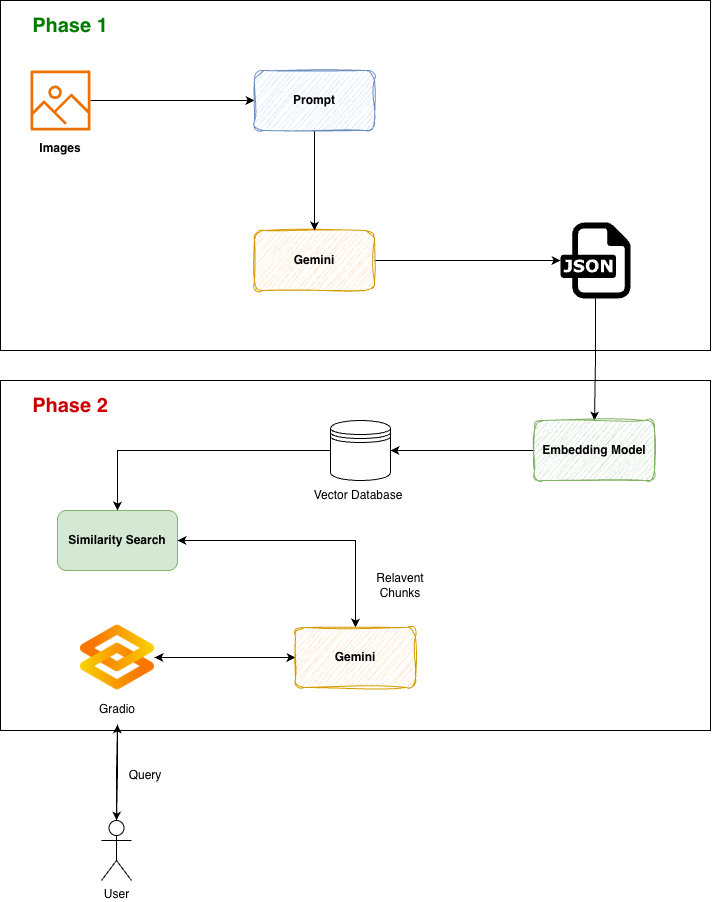

## The prompt

In [ ]:
image_description_prompt = """
**Role:**
You are an expert Computer Vision Metadata Specialist and SEO Archivist. You possess a deep understanding of visual semantics, image indexing, and natural language retrieval. Your capability involves translating visual data into precise, machine-readable text optimized for search algorithms.

**Context:**
We are building a high-performance multimodal search engine. The metadata you generate will be used to populate a vector database, allowing users to find images using both specific keyword matching and semantic natural language queries (e.g., "a quiet place to work with coffee"). High accuracy and descriptive depth are required to distinguish between similar images.

**Task:**
Analyze the provided image and generate a structured JSON object containing detailed metadata. You must extract the main subject, describe the scene atmospherics, identify visual elements, transcribe specific text, and generate search-optimized keywords.

**Constraints:**

1.  **Description:** Must be objective and factual. Limit to 2-3 sentences. Focus on action, lighting, and mood.
2.  **Text Content:** If no text is visible, return `null`. If text is visible, transcribe it exactly as it appears, preserving case where possible.
3.  **Keywords:** Provide exactly 10-15 keywords. Mix broad concepts (e.g., "urban," "melancholy") with specific objects (e.g., "red umbrella," "taxi").
4.  **Safety:** Do not generate content that violates safety policies. If the image is unclear or blurry, note this in the description.
5.  **Format:** The output must be raw JSON only. Do not include markdown formatting (like ` json ...  `) or conversational filler.

**Examples:**

*Input:* [An image of a golden retriever catching a frisbee in a park on a sunny day]

*Output:*

```json
{
  "main_subject": "Golden Retriever dog",
  "detailed_description": "A golden retriever leaps into the air to catch a red frisbee against a clear blue sky. The lighting is bright and natural, casting sharp shadows on the green grass below. The mood is energetic and playful.",
  "visual_elements": [
    "Golden Retriever",
    "Red Frisbee",
    "Green Grass",
    "Blue Sky",
    "Motion Blur"
  ],
  "text_content": null,
  "search_keywords": [
    "dog",
    "pet",
    "playing",
    "fetch",
    "frisbee",
    "park",
    "sunny",
    "action shot",
    "canine",
    "jumping",
    "outdoor",
    "joyful",
    "golden retriever",
    "summer"
  ]
}
```

**Output Format:**
Generate the response in the following JSON structure:

```json
{
  "main_subject": "String",
  "detailed_description": "String",
  "visual_elements": ["String", "String"],
  "text_content": "String or null",
  "search_keywords": ["String", "String"]
}
```
"""

# Processing One Image

In [ ]:
import os
import base64
import mimetypes
from google.colab import userdata
from langchain_google_genai import ChatGoogleGenerativeAI
from langchain_core.messages import HumanMessage


In [ ]:
import os
import base64
import mimetypes
from google.colab import userdata
from langchain_google_genai import ChatGoogleGenerativeAI
from langchain_core.messages import HumanMessage

# 1. Setup
os.environ["GOOGLE_API_KEY"] = userdata.get("GOOGLE_API_KEY")

# Initialize the model
llm = ChatGoogleGenerativeAI(
    model="gemini-2.5-flash",
    temperature=0.2
)

# 2. Helper function to encode image to Base64
def encode_image(image_path):
    """Encodes a local image to base64 string."""
    # https://en.wikipedia.org/wiki/Base64
    with open(image_path, "rb") as image_file:
        return base64.b64encode(image_file.read()).decode('utf-8')

# 3. The Metadata Function
def generate_search_metadata(image_path, llm, prompt_text):
    """
    Generates a detailed description using LangChain and Gemini.
    """
    try:
        # Determine mime type (e.g., 'image/jpeg', 'image/png')
        mime_type, _ = mimetypes.guess_type(image_path)
        if not mime_type:
            mime_type = 'image/jpeg' # Default fallback

        # Get Base64 string
        img_base64 = encode_image(image_path)

        # Create the Multimodal Message
        # LangChain expects a list of dictionaries for multimodal content
        message = HumanMessage(
            content=[
                {"type": "text", "text": prompt_text},
                {
                    "type": "image_url",
                    "image_url": {"url": f"data:{mime_type};base64,{img_base64}"}
                }
            ]
        )

        # Invoke the LLM
        response = llm.invoke([message])

        return response.content.replace('```json', '').replace('```', '')

    except FileNotFoundError:
        print(f"Error: The file at {image_path} was not found.")
        return None
    except Exception as e:
        print(f"An error occurred during generation: {e}")
        return None

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

In [ ]:
image_path = "/content/drive/MyDrive/Bootcamp/images/IMG_0595.JPG"

# Run the function
metadata = generate_search_metadata(image_path, llm, image_description_prompt)

if metadata:
    print(metadata)

# Processing All Images

In [ ]:
import os
import json

source_folder = "/content/drive/MyDrive/Bootcamp/images"
output_folder = "/content/drive/MyDrive/Bootcamp/jsons"

os.makedirs(output_folder, exist_ok=True)

# Supported image extensions to filter for
valid_extensions = ('.jpg', '.jpeg', '.png', '.webp', '.heic')

print(f"Starting processing for images in: {source_folder}\n")

files = os.listdir(source_folder)
# Calculate total relevant files for the progress counter
total_files = len([f for f in files if f.lower().endswith(valid_extensions)])
processed_count = 0

for filename in files:
    if filename.lower().endswith(valid_extensions):

        image_path = os.path.join(source_folder, filename)

        # Define the output JSON path (same name as image, but .json extension)
        json_filename = f"{os.path.splitext(filename)[0]}.json"
        json_path = os.path.join(output_folder, json_filename)

        if os.path.exists(json_path):
            print(f"[{processed_count + 1}/{total_files}] Skipping: {filename} (JSON already exists)")
            processed_count += 1
            continue

        print(f"[{processed_count + 1}/{total_files}] Generating metadata for: {filename}...")

        try:
            # Call your existing function
            description = generate_search_metadata(image_path, llm, image_description_prompt)

            # Ensure description is parsed to dict if returned as string
            if isinstance(description, str):
                description = json.loads(description)

            if description:
                # Prepare the data structure
                data = {
                    "file_path": image_path,
                    "description": description
                }

                # Write to JSON file
                with open(json_path, 'w', encoding='utf-8') as json_file:
                    json.dump(data, json_file, indent=4)

                print(f"   -> Saved to {json_filename}")
            else:
                print(f"   -> Skipped {filename} (Generation returned empty)")

        except Exception as e:
            print(f"   -> Error processing {filename}: {e}")

        processed_count += 1

print("\n--- Processing Complete ---")

# Creating Embeddings

In [ ]:
!pip install -U -q langchain-google-genai langchain-chroma chromadb

In [ ]:
import os
import json
import time
from langchain_google_genai import GoogleGenerativeAIEmbeddings
from langchain_chroma import Chroma
from langchain_core.documents import Document
from google.colab import userdata

# 1. Setup
os.environ["GOOGLE_API_KEY"] = userdata.get("GOOGLE_API_KEY")
json_folder = "/content/drive/MyDrive/0. GFG/Content/Events/Bootcamp/jsons/"
db_path = "/content/drive/MyDrive/0. GFG/Content/Events/Bootcamp/chroma_db"

# Initialize Embeddings
embeddings = GoogleGenerativeAIEmbeddings(model="models/text-embedding-004")

# 2. Check if DB exists before doing heavy lifting
# We check if the folder exists and is not empty (Chroma creates files inside)
db_exists = os.path.exists(db_path) and os.listdir(db_path)

if db_exists:
    print(f"Database found at {db_path}. Loading existing VectorStore...")
    vectorstore = Chroma(
        persist_directory=db_path,
        embedding_function=embeddings
    )
    print(f"Loaded existing DB with {vectorstore._collection.count()} documents.")

else:
    print("Database not found. Starting ingestion process...")

    # Load ALL JSONs into a list of Documents first (No API calls here)
    documents = []

    if os.path.exists(json_folder):
        files = [f for f in os.listdir(json_folder) if f.endswith('.json')]
        print(f"Found {len(files)} JSON files. Preparing data...")

        for filename in files:
            file_path = os.path.join(json_folder, filename)
            with open(file_path, 'r', encoding='utf-8') as f:
                data = json.load(f)
                desc_obj = data.get("description", {})

                # Construct Context
                text_content = f"""
                Subject: {desc_obj.get('main_subject', 'Unknown')}
                Description: {desc_obj.get('detailed_description', '')}
                Keywords: {', '.join(desc_obj.get('search_keywords', []))}
                Visual Elements: {', '.join(desc_obj.get('visual_elements', []))}
                """

                doc = Document(
                    page_content=text_content,
                    metadata={
                        "file_name": data.get("file_name", filename),
                        "file_path": data.get("file_path", "")
                    }
                )
                documents.append(doc)
    else:
        print("JSON folder not found.")

    # 3. Add to Chroma in Batches with Timeout
    if documents:
        print(f"Loaded {len(documents)} documents. Starting ingestion with rate limits...")

        # Initialize the DB (This creates the folder)
        vectorstore = Chroma(
            persist_directory=db_path,
            embedding_function=embeddings
        )

        BATCH_SIZE = 5
        total_batches = (len(documents) + BATCH_SIZE - 1) // BATCH_SIZE

        for i in range(0, len(documents), BATCH_SIZE):
            batch = documents[i : i + BATCH_SIZE]
            current_batch_num = (i // BATCH_SIZE) + 1

            print(f"Processing Batch {current_batch_num}/{total_batches} ({len(batch)} docs)...")

            # A. Add documents (This triggers the API Call)
            vectorstore.add_documents(batch)

            # B. Wait if this is not the last batch
            if i + BATCH_SIZE < len(documents):
                print("   -> Waiting 60 seconds to respect rate limits...")
                time.sleep(60)

        print(f"\nSuccess! All documents saved to: {db_path}")

    else:
        print("No documents to process.")

In [ ]:
import os
from langchain_chroma import Chroma
from langchain_google_genai import GoogleGenerativeAIEmbeddings
from google.colab import userdata
from IPython.display import display, Image


db_path = "/content/drive/MyDrive/0. GFG/Content/Events/Bootcamp/chroma_db"

# IMPORTANT: Must use the exact same model name you used to create the DB
embeddings = GoogleGenerativeAIEmbeddings(model="models/text-embedding-004")

# Load the Database
# We point to the persist_directory to load the existing index
vectorstore = Chroma(
    persist_directory=db_path,
    embedding_function=embeddings
)

print("Database loaded successfully!")

def search_images(query, top_k=3):
    """
    Searches the vector DB for images matching the text query.
    """

    # Perform Similarity Search
    # This embeds the query and finds the 'top_k' closest vectors
    results = vectorstore.similarity_search(query, k=top_k)

    if not results:
        print("No matches found.")
        return

    # Display Results
    for i, doc in enumerate(results):
        file_path = doc.metadata.get("file_path")
        subject = doc.metadata.get("main_subject")
        file_name = doc.metadata.get("file_name")

        print(f"Match #{i+1}")
        print(f"File: {file_name}")
        print(f"Context: {doc.page_content[:100]}...") # Show first 100 chars of description

        # Display the actual image
        if os.path.exists(file_path):
            display(Image(filename=file_path, width=300))
        else:
            print(f"Image file not found at: {file_path}")

        print("-" * 40)


# Example 1: Conceptual search
search_images("cat")

In [ ]:
search_images("dog")

user query - 0.2
embiddings - 0.8 , 20, 40 , 52, 65,  

# Submissions

**Take Any dataset of images to your choice , ( it should contain your personal data ) (atleast 15-20) of them and implement this RAG into it , and submit the link of the notebook with your generations**

##Project 17 Submission

For the project submission, I will be using the above code but with my Google Drive and Gemini Key to generate .json texts and embeddings of photos of dogs. I am also using limited Gemini API keys, hence the code to swap between keys. I made the submission so that everything below this cell should be able to run without prior cells running and risking unneccessary API calls.


In [1]:
!pip install --upgrade --quiet langchain-google-genai

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 53.1/53.1 kB 1.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 66.5/66.5 kB 2.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 719.4/719.4 kB 21.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 236.5/236.5 kB 8.5 MB/s eta 0:00:00
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
google-colab 1.0.0 requires google-auth==2.43.0, but you have google-auth 2.48.0 which is incompatible.


#### API Key Rotation Strategy

To implement API key rotation, you would first store multiple API keys in your Colab Secrets (the 🔑 icon in the left sidebar). You can name them sequentially, like `GOOGLE_API_KEY_1`, `GOOGLE_API_KEY_2`, `GOOGLE_API_KEY_3`, and so on. The code will then retrieve these and cycle through them.

We'll define a simple `APIKeyManager` class that holds these keys and allows you to get the current active key or switch to the next one.

In [2]:
import os
from google.colab import userdata

class APIKeyManager:
    def __init__(self, key_prefix='GOOGLE_API_KEY', num_keys=3):
        self.keys = []
        for i in range(1, num_keys + 1):
            if i == 1:
                key_name = key_prefix
            else:
                key_name = f'{key_prefix}_{i}'
            key_value = userdata.get(key_name)
            if key_value:
                self.keys.append(key_value)
            else:
                print(f"Warning: API Key '{key_name}' not found in Colab secrets.")

        if not self.keys:
            raise ValueError("No API keys loaded. Please ensure keys are set in Colab secrets.")

        self.current_key_index = 0
        print(f"APIKeyManager initialized with {len(self.keys)} keys.")

    def get_current_key(self):
        return self.keys[self.current_key_index]

    def switch_key(self):
        if len(self.keys) == 1:
            print("Only one API key available. Cannot switch.")
            return False

        self.current_key_index = (self.current_key_index + 1) % len(self.keys)
        print(f"Switched to API key index {self.current_key_index + 1}/{len(self.keys)}.")
        return True

# Example of how you would retrieve your keys and manage them
# Assuming you have GOOGLE_API_KEY_1, GOOGLE_API_KEY_2, GOOGLE_API_KEY_3 in Colab secrets
api_key_manager = APIKeyManager(num_keys=4) # Adjust num_keys based on how many keys you have

# Set the initial active key for the environment
os.environ["GOOGLE_API_KEY"] = api_key_manager.get_current_key()
print(f"Initial GOOGLE_API_KEY set from manager.")


APIKeyManager initialized with 4 keys.
Initial GOOGLE_API_KEY set from manager.


In [3]:
from langchain_google_genai import ChatGoogleGenerativeAI, GoogleGenerativeAIEmbeddings
from langchain_core.messages import HumanMessage
import time
import json

# --- Re-initialize LLM and Embeddings with the manager ---
# (This would replace similar lines in your existing setup code)

llm = ChatGoogleGenerativeAI(
    model="gemini-2.5-flash",
    temperature=0.2
)

embeddings = GoogleGenerativeAIEmbeddings(model="models/text-embedding-004")

print("LLM and Embeddings initialized with the current active API key.")

# --- Example of how you would integrate retry logic with key rotation ---
# This is a conceptual example. Actual API error handling might need more specific exception types.

def safe_llm_invoke(llm_instance, message, manager):
    for _ in range(len(manager.keys)): # Try each key once
        try:
            os.environ["GOOGLE_API_KEY"] = manager.get_current_key()
            # Re-initialize the LLM object with the new key in the environment
            # This is often necessary because the key is typically read at initialization.
            llm_instance = ChatGoogleGenerativeAI(
                model="gemini-2.5-flash",
                temperature=0.2
            )
            response = llm_instance.invoke([message])
            return response.content.replace('```json', '').replace('```', '')
        except Exception as e:
            print(f"API request failed with current key: {e}")
            if "rate limit" in str(e).lower() or "invalid api key" in str(e).lower(): # Generic check, be more specific if possible
                print("Attempting to switch API key...")
                if not manager.switch_key():
                    print("All API keys exhausted or only one key available.")
                    break
                time.sleep(5) # Wait a bit before retrying with the new key
            else:
                raise # Re-raise other unexpected errors
    raise Exception("Failed to get LLM response after trying all available API keys.")

def safe_add_documents(vectorstore_instance, batch, manager):
    for _ in range(len(manager.keys)): # Try each key once
        try:
            os.environ["GOOGLE_API_KEY"] = manager.get_current_key()
            # Re-initialize embeddings if needed, or if Chroma directly uses the env var
            # Note: Chroma's embedding_function is typically set once.
            # If the embedding_function itself needs a new key, you'd likely re-create the embeddings object
            # and potentially the Chroma instance (or update its embedding function) if the API key is tied to its instantiation.
            # For simplicity, we assume setting os.environ is enough if the embedding function fetches the key on call.
            vectorstore_instance.add_documents(batch)
            return True
        except Exception as e:
            print(f"Embedding request failed with current key: {e}")
            if "rate limit" in str(e).lower() or "invalid api key" in str(e).lower(): # Generic check
                print("Attempting to switch API key...")
                if not manager.switch_key():
                    print("All API keys exhausted or only one key available.")
                    break
                time.sleep(5) # Wait a bit before retrying with the new key
            else:
                raise # Re-raise other unexpected errors
    raise Exception("Failed to add documents after trying all available API keys.")

def safe_similarity_search(vectorstore_instance, query, top_k = 3, manager = None):
    for _ in range(len(manager.keys)): # Try each key once
        try:
          os.environ["GOOGLE_API_KEY"] = manager.get_current_key()
          results = vectorstore_instance.similarity_search(query, top_k)
          return results
        except Exception as e:
          print(f"Embedding request failed with current key: {e}")
          if "rate limit" in str(e).lower() or "invalid api key" in str(e).lower(): # Generic check
            print("Attempting to switch API key...")
            if not manager.switch_key():
              print("All API keys exhausted or only one key available.")
              break
            time.sleep(5) # Wait a bit before retrying with the new key
          else:
            raise # Re-raise other unexpected errors
    raise Exception("Failed to add documents after trying all available API keys.")


LLM and Embeddings initialized with the current active API key.


#### How to integrate with your existing code:

YouYou would integrate the `APIKeyManager` class into your existing processing loops. For example:

1.  **Modify your `generate_search_metadata` function** to use `safe_llm_invoke` instead of `llm.invoke` directly.
2.  **Modify your `Chroma` ingestion loop** (where `vectorstore.add_documents(batch)` is called) to use `safe_add_documents`.

This approach ensures that if an API request fails due to a rate limit or an invalid key, the system attempts to switch to an alternative key and retries the operation, improving the robustness of your application.

Remember that detecting a rate limit error or an invalid key from a generic `Exception` often requires inspecting the error message or specific exception types returned by the API client. The example above uses a generic `in str(e).lower()` check, which might need refinement based on actual API error responses.

###Creating Prompt

In [4]:
p17_image_description_prompt = """
**Role:**
You are an expert Computer Vision Metadata Specialist and SEO Archivist. You possess a deep understanding of visual semantics, image indexing, and natural language retrieval. Your capability involves translating visual data into precise, machine-readable text optimized for search algorithms.

**Context:**
We are building a high-performance multimodal search engine. The metadata you generate will be used to populate a vector database, allowing users to find images using both specific keyword matching and semantic natural language queries (e.g., "a quiet place to work with coffee"). High accuracy and descriptive depth are required to distinguish between similar images.

**Task:**
Analyze the provided image and generate a structured JSON object containing detailed metadata. You must extract the main subject, describe the scene atmospherics, identify visual elements, transcribe specific text, and generate search-optimized keywords.

**Constraints:**

1.  **Description:** Must be objective and factual. Limit to 2-3 sentences. Focus on action, lighting, and mood.
2.  **Text Content:** If no text is visible, return `null`. If text is visible, transcribe it exactly as it appears, preserving case where possible.
3.  **Keywords:** Provide exactly 10-15 keywords. Mix broad concepts (e.g., "urban," "melancholy") with specific objects (e.g., "red umbrella," "taxi").
4.  **Safety:** Do not generate content that violates safety policies. If the image is unclear or blurry, note this in the description.
5.  **Format:** The output must be raw JSON only. Do not include markdown formatting (like ` json ...  `) or conversational filler.

**Examples:**

*Input:* [An image of a golden retriever catching a frisbee in a park on a sunny day]

*Output:*

```json
{
  "main_subject": "Golden Retriever dog",
  "detailed_description": "A golden retriever leaps into the air to catch a red frisbee against a clear blue sky. The lighting is bright and natural, casting sharp shadows on the green grass below. The mood is energetic and playful.",
  "visual_elements": [
    "Golden Retriever",
    "Red Frisbee",
    "Green Grass",
    "Blue Sky",
    "Motion Blur"
  ],
  "text_content": null,
  "search_keywords": [
    "dog",
    "pet",
    "playing",
    "fetch",
    "frisbee",
    "park",
    "sunny",
    "action shot",
    "canine",
    "jumping",
    "outdoor",
    "joyful",
    "golden retriever",
    "summer"
  ]
}
```

**Output Format:**
Generate the response in the following JSON structure:

```json
{
  "main_subject": "String",
  "detailed_description": "String",
  "visual_elements": ["String", "String"],
  "text_content": "String or null",
  "search_keywords": ["String", "String"]
}
```
"""

In [5]:
import os
import base64
import mimetypes
from google.colab import userdata
from langchain_google_genai import ChatGoogleGenerativeAI
from langchain_core.messages import HumanMessage

# 1. Setup
os.environ["GOOGLE_API_KEY"] = userdata.get("GOOGLE_API_KEY")

# Initialize the model
llm = ChatGoogleGenerativeAI(
    model="gemini-2.5-flash",
    temperature=0.2
)

# 2. Helper function to encode image to Base64
def encode_image(image_path):
    """Encodes a local image to base64 string."""
    # https://en.wikipedia.org/wiki/Base64
    with open(image_path, "rb") as image_file:
        return base64.b64encode(image_file.read()).decode('utf-8')

# 3. The Metadata Function
def generate_search_metadata(image_path, llm, prompt_text):
    """
    Generates a detailed description using LangChain and Gemini.
    """
    try:
        # Determine mime type (e.g., 'image/jpeg', 'image/png')
        mime_type, _ = mimetypes.guess_type(image_path)
        if not mime_type:
            mime_type = 'image/jpeg' # Default fallback

        # Get Base64 string
        img_base64 = encode_image(image_path)

        # Create the Multimodal Message
        # LangChain expects a list of dictionaries for multimodal content
        message = HumanMessage(
            content=[
                {"type": "text", "text": prompt_text},
                {
                    "type": "image_url",
                    "image_url": {"url": f"data:{mime_type};base64,{img_base64}"}
                }
            ]
        )

        # Invoke the LLM
        #response = llm.invoke([message])
        response = safe_llm_invoke(llm, message, api_key_manager)
        #return response.content.replace('```json', '').replace('```', '')
        return response

    except FileNotFoundError:
        print(f"Error: The file at {image_path} was not found.")
        return None
    except Exception as e:
        print(f"An error occurred during generation: {e}")
        return None

In [6]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


####Testing the code to process one image.



In [7]:
image_path = "/content/drive/MyDrive/GfG_Project_17/Images/IMG_0011.jpeg"

# Run the function
metadata = generate_search_metadata(image_path, llm, p17_image_description_prompt)

if metadata:
    print(metadata)
else:
  print ("Error.")


{
  "main_subject": "Sleeping puppy with a blue bow",
  "detailed_description": "A light-colored puppy, wearing a blue bow around its neck, is curled up and sleeping peacefully on a patterned area rug. The scene is softly lit, highlighting the puppy's fur and creating a warm, cozy atmosphere. A person's legs, clad in black pants and red footwear, are partially visible in the background.",
  "visual_elements": [
    "Puppy",
    "Blue bow",
    "Patterned rug",
    "Person's legs",
    "Black pants",
    "Red shoes",
    "Brick floor"
  ],
  "text_content": null,
  "search_keywords": [
    "puppy",
    "sleeping",
    "cute",
    "dog",
    "pet",
    "domestic",
    "rug",
    "blue bow",
    "cozy",
    "peaceful",
    "indoors",
    "animal",
    "companion",
    "newborn puppy",
    "golden retriever puppy"
  ]
}



###Processing Images

In [8]:
import os
import json

source_folder = "/content/drive/MyDrive/GfG_Project_17/Images"
output_folder = "/content/drive/MyDrive/GfG_Project_17/jsons"

os.makedirs(output_folder, exist_ok=True)

# Supported image extensions to filter for
valid_extensions = ('.jpg', '.jpeg', '.png', '.webp', '.heic')

print(f"Starting processing for images in: {source_folder}\n")

files = os.listdir(source_folder)
# Calculate total relevant files for the progress counter
total_files = len([f for f in files if f.lower().endswith(valid_extensions)])
processed_count = 0

for filename in files:
    if filename.lower().endswith(valid_extensions):

        image_path = os.path.join(source_folder, filename)

        # Define the output JSON path (same name as image, but .json extension)
        json_filename = f"{os.path.splitext(filename)[0]}.json"
        json_path = os.path.join(output_folder, json_filename)

        if os.path.exists(json_path):
            print(f"[{processed_count + 1}/{total_files}] Skipping: {filename} (JSON already exists)")
            processed_count += 1
            continue

        print(f"[{processed_count + 1}/{total_files}] Generating metadata for: {filename}...")

        try:
            # Call your existing function
            description = generate_search_metadata(image_path, llm, p17_image_description_prompt)

            # Ensure description is parsed to dict if returned as string
            if isinstance(description, str):
                description = json.loads(description)

            if description:
                # Prepare the data structure
                data = {
                    "file_path": image_path,
                    "description": description
                }

                # Write to JSON file
                with open(json_path, 'w', encoding='utf-8') as json_file:
                    json.dump(data, json_file, indent=4)

                print(f"   -> Saved to {json_filename}")
            else:
                print(f"   -> Skipped {filename} (Generation returned empty)")

        except Exception as e:
            print(f"   -> Error processing {filename}: {e}")

        processed_count += 1

print("\n--- Processing Complete ---")

Starting processing for images in: /content/drive/MyDrive/GfG_Project_17/Images

[1/16] Skipping: IMG_2045.jpeg (JSON already exists)
[2/16] Skipping: IMG_0307.jpeg (JSON already exists)
[3/16] Skipping: IMG_3756.jpeg (JSON already exists)
[4/16] Skipping: IMG_0472.jpeg (JSON already exists)
[5/16] Skipping: IMG_0041.jpeg (JSON already exists)
[6/16] Skipping: IMG_0176.jpeg (JSON already exists)
[7/16] Skipping: IMG_0918.jpeg (JSON already exists)
[8/16] Skipping: IMG_3885.jpeg (JSON already exists)
[9/16] Skipping: IMG_0011.jpeg (JSON already exists)
[10/16] Skipping: IMG_1792.jpeg (JSON already exists)
[11/16] Skipping: IMG_1171.jpeg (JSON already exists)
[12/16] Skipping: IMG_2220.jpeg (JSON already exists)
[13/16] Skipping: IMG_0612.jpeg (JSON already exists)
[14/16] Skipping: IMG_9379.jpeg (JSON already exists)
[15/16] Skipping: IMG_3790.jpeg (JSON already exists)
[16/16] Skipping: IMG_1060.jpeg (JSON already exists)

--- Processing Complete ---


###Creating Embeddings

In [9]:
!pip install -U -q langchain-google-genai langchain-chroma chromadb

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 52.0/52.0 kB 2.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 21.1/21.1 MB 65.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 278.2/278.2 kB 13.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.0/2.0 MB 66.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 17.4/17.4 MB 58.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 72.5/72.5 kB 3.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 132.6/132.6 kB 8.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 66.4/66.4 kB 3.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 220.0/220.0 kB 12.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 105.4/105.4 kB 4.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 71.6/71.6 kB 4.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 60.6/60.6 kB 3.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 46.0/46

Note: If you get an error about the chroma_db you may need to delete the chroma_db in the files or disconnect and delete the runtime, then rerun the code from either the begining of the submission section or when you mount your Google Drive in order for it to work.

In [10]:
import os
import json
import time
from langchain_google_genai import GoogleGenerativeAIEmbeddings
from langchain_chroma import Chroma
from langchain_core.documents import Document
from google.colab import userdata

# 1. Setup
os.environ["GOOGLE_API_KEY"] = userdata.get("GOOGLE_API_KEY")
#json_folder = "/content/drive/MyDrive/0. GFG/Content/Events/Bootcamp/jsons/"
#db_path = "/content/drive/MyDrive/0. GFG/Content/Events/Bootcamp/chroma_db"
json_folder = "/content/drive/MyDrive/GfG_Project_17/jsons"
db_path = "/content/drive/MyDrive/GfG_Project_17/chroma_db"


# Initialize Embeddings
embeddings = GoogleGenerativeAIEmbeddings(model="models/text-embedding-004")

# 2. Check if DB exists before doing heavy lifting
# We check if the folder exists and is not empty (Chroma creates files inside)
db_exists = os.path.exists(db_path) and os.listdir(db_path)

if db_exists:
    print(f"Database found at {db_path}. Loading existing VectorStore...")
    vectorstore = Chroma(
        persist_directory=db_path,
        embedding_function=embeddings
    )
    print(f"Loaded existing DB with {vectorstore._collection.count()} documents.")

else:
    print("Database not found. Starting ingestion process...")

    # Load ALL JSONs into a list of Documents first (No API calls here)
    documents = []

    if os.path.exists(json_folder):
        files = [f for f in os.listdir(json_folder) if f.endswith('.json')]
        print(f"Found {len(files)} JSON files. Preparing data...")

        for filename in files:
            file_path = os.path.join(json_folder, filename)
            with open(file_path, 'r', encoding='utf-8') as f:
                data = json.load(f)
                desc_obj = data.get("description", {})

                # Construct Context
                text_content = f"""
                Subject: {desc_obj.get('main_subject', 'Unknown')}
                Description: {desc_obj.get('detailed_description', '')}
                Keywords: {', '.join(desc_obj.get('search_keywords', []))}
                Visual Elements: {', '.join(desc_obj.get('visual_elements', []))}
                """

                doc = Document(
                    page_content=text_content,
                    metadata={
                        "file_name": data.get("file_name", filename),
                        "file_path": data.get("file_path", "")
                    }
                )
                documents.append(doc)
    else:
        print("JSON folder not found.")

    # 3. Add to Chroma in Batches with Timeout
    if documents:
        print(f"Loaded {len(documents)} documents. Starting ingestion with rate limits...")

        # Initialize the DB (This creates the folder)
        vectorstore = Chroma(
            persist_directory=db_path,
            embedding_function=embeddings
        )

        BATCH_SIZE = 5
        total_batches = (len(documents) + BATCH_SIZE - 1) // BATCH_SIZE

        for i in range(0, len(documents), BATCH_SIZE):
            batch = documents[i : i + BATCH_SIZE]
            current_batch_num = (i // BATCH_SIZE) + 1

            print(f"Processing Batch {current_batch_num}/{total_batches} ({len(batch)} docs)...")

            # A. Add documents (This triggers the API Call)
            #vectorstore.add_documents(batch)
            safe_add_documents(vectorstore, batch, api_key_manager)
            # B. Wait if this is not the last batch
            if i + BATCH_SIZE < len(documents):
                print("   -> Waiting 60 seconds to respect rate limits...")
                time.sleep(60)

        print(f"\nSuccess! All documents saved to: {db_path}")

    else:
        print("No documents to process.")

Database not found. Starting ingestion process...
Found 16 JSON files. Preparing data...
Loaded 16 documents. Starting ingestion with rate limits...
Processing Batch 1/4 (5 docs)...
   -> Waiting 60 seconds to respect rate limits...
Processing Batch 2/4 (5 docs)...
   -> Waiting 60 seconds to respect rate limits...
Processing Batch 3/4 (5 docs)...
   -> Waiting 60 seconds to respect rate limits...
Processing Batch 4/4 (1 docs)...

Success! All documents saved to: /content/drive/MyDrive/GfG_Project_17/chroma_db


###Testing Image Search Code

Database loaded successfully!
Match #1
File: IMG_0011.json
Context: 
                Subject: Sleeping puppy
                Description: A cream-colored puppy, wearing...


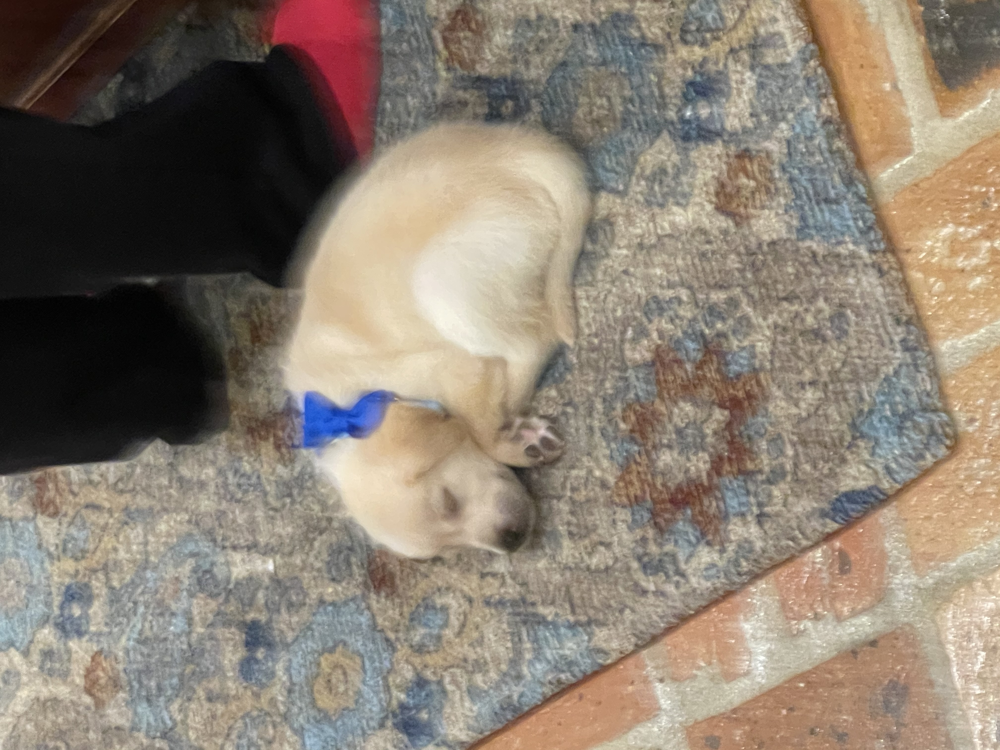

----------------------------------------
Match #2
File: IMG_3790.json
Context: 
                Subject: Bulldog puppy
                Description: A young bulldog puppy with whit...


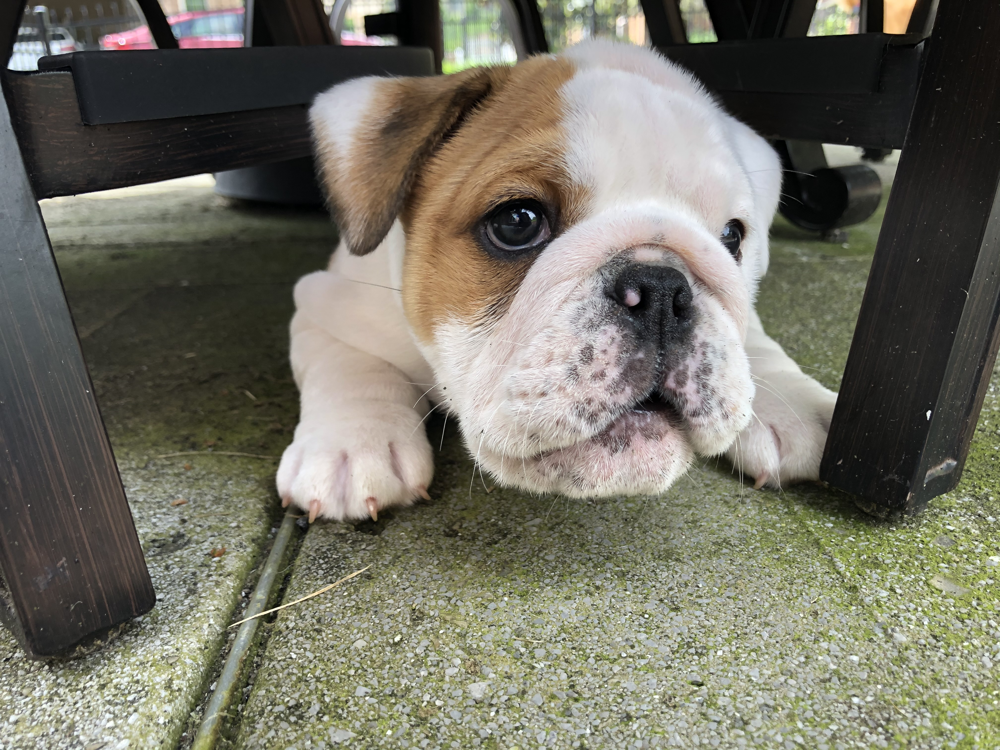

----------------------------------------
Match #3
File: IMG_3756.json
Context: 
                Subject: Puppy's face
                Description: A very close-up, eye-level shot ...


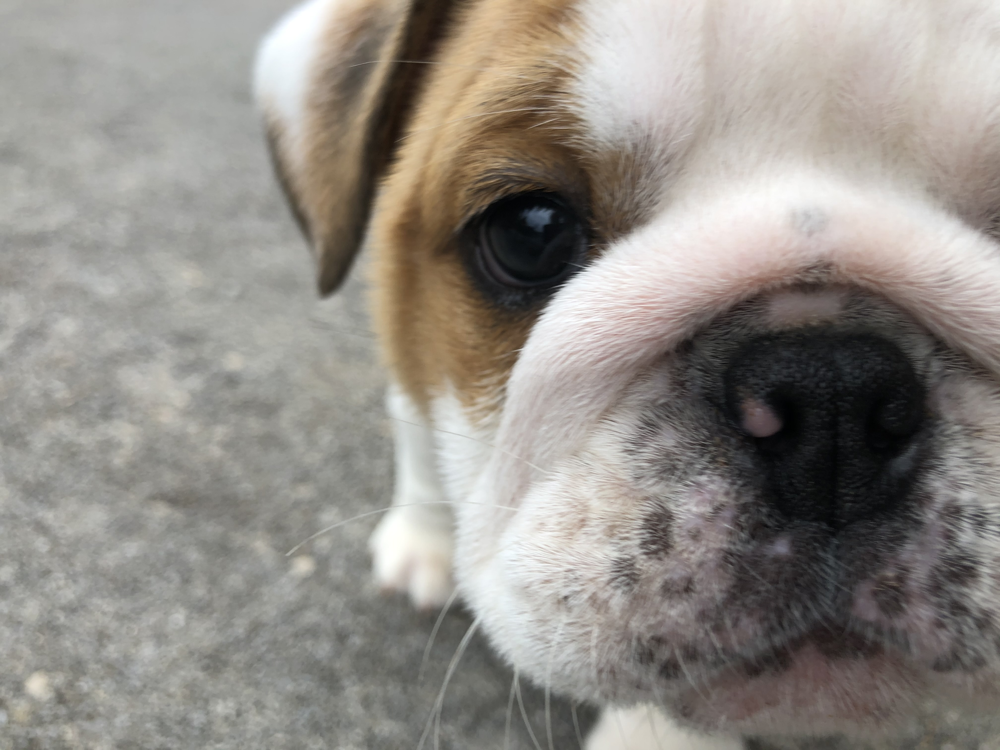

----------------------------------------


In [11]:
import os
from langchain_chroma import Chroma
from langchain_google_genai import GoogleGenerativeAIEmbeddings
from google.colab import userdata
from IPython.display import display, Image


db_path = "/content/drive/MyDrive/GfG_Project_17/chroma_db"

# IMPORTANT: Must use the exact same model name you used to create the DB
embeddings = GoogleGenerativeAIEmbeddings(model="models/text-embedding-004")

# Load the Database
# We point to the persist_directory to load the existing index
vectorstore = Chroma(
    persist_directory=db_path,
    embedding_function=embeddings
)

print("Database loaded successfully!")

def search_images(query, top_k=3):
    """
    Searches the vector DB for images matching the text query.
    """

    # Perform Similarity Search
    # This embeds the query and finds the 'top_k' closest vectors
    #results = vectorstore.similarity_search(query, k=top_k)
    results = safe_similarity_search(vectorstore, query, top_k=top_k, manager=api_key_manager)

    if not results:
        print("No matches found.")
        return

    # Display Results
    for i, doc in enumerate(results):
        file_path = doc.metadata.get("file_path")
        subject = doc.metadata.get("main_subject")
        file_name = doc.metadata.get("file_name")

        print(f"Match #{i+1}")
        print(f"File: {file_name}")
        print(f"Context: {doc.page_content[:100]}...") # Show first 100 chars of description

        # Display the actual image
        if os.path.exists(file_path):
            display(Image(filename=file_path, width=300))
        else:
            print(f"Image file not found at: {file_path}")

        print("-" * 40)


# Example 1: Conceptual search
search_images("puppy")

Match #1
File: IMG_0918.json
Context: 
                Subject: White Bulldog
                Description: A white bulldog stands on a pol...


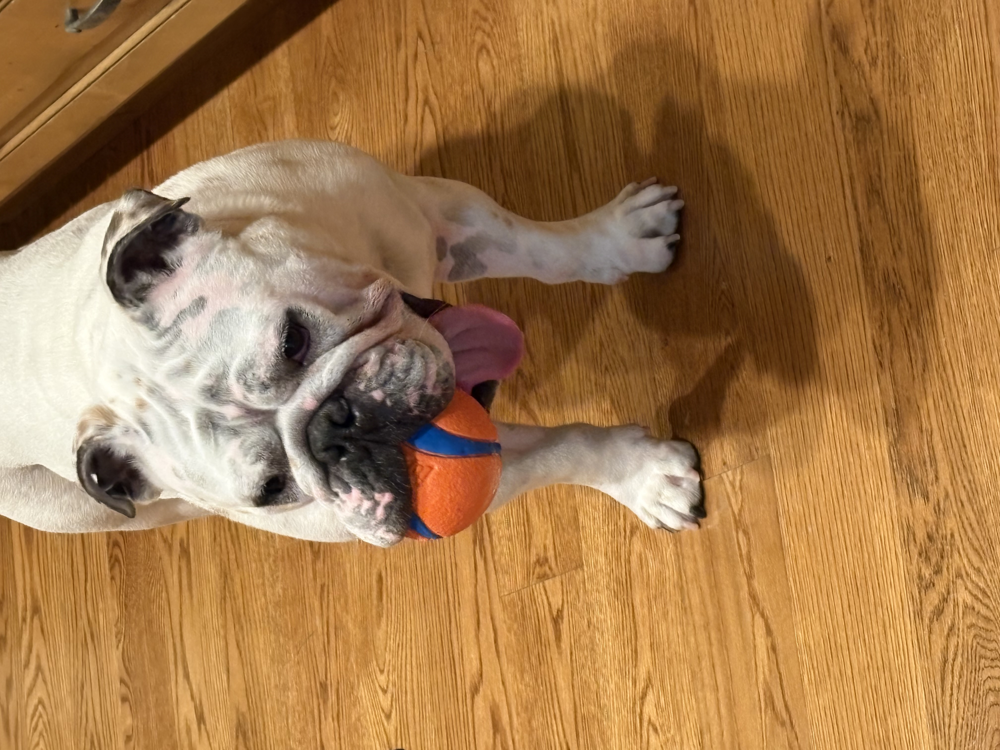

----------------------------------------
Match #2
File: IMG_2220.json
Context: 
                Subject: Dog in a dog bed
                Description: A light brown dog is curled ...


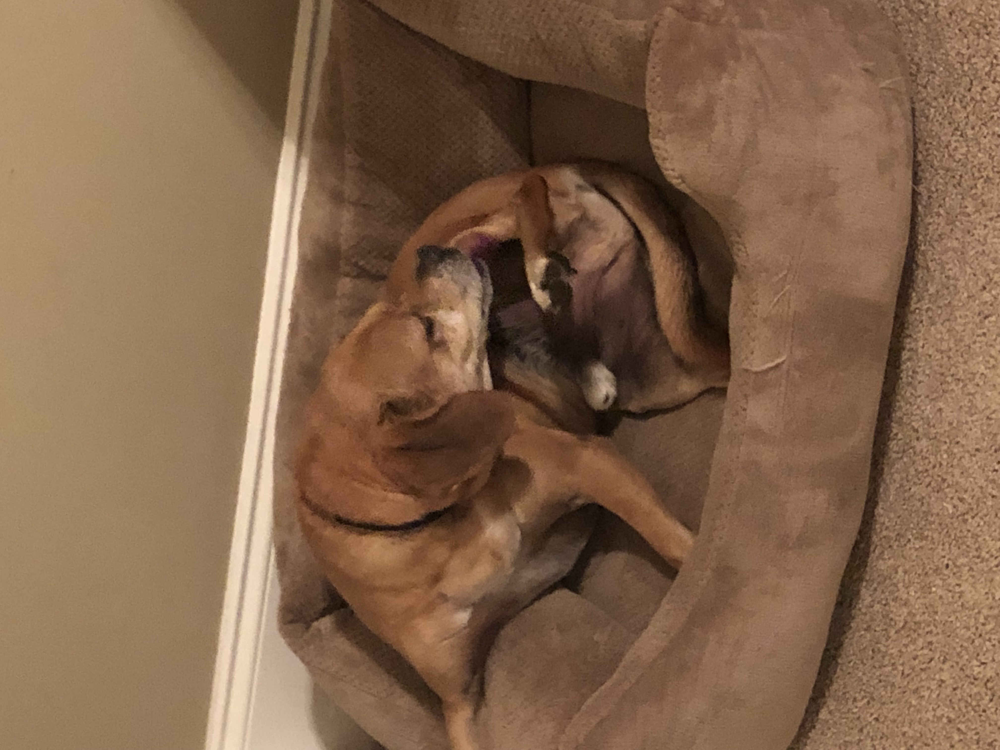

----------------------------------------
Match #3
File: IMG_0472.json
Context: 
                Subject: Three bulldogs
                Description: Three bulldogs are resting on ...


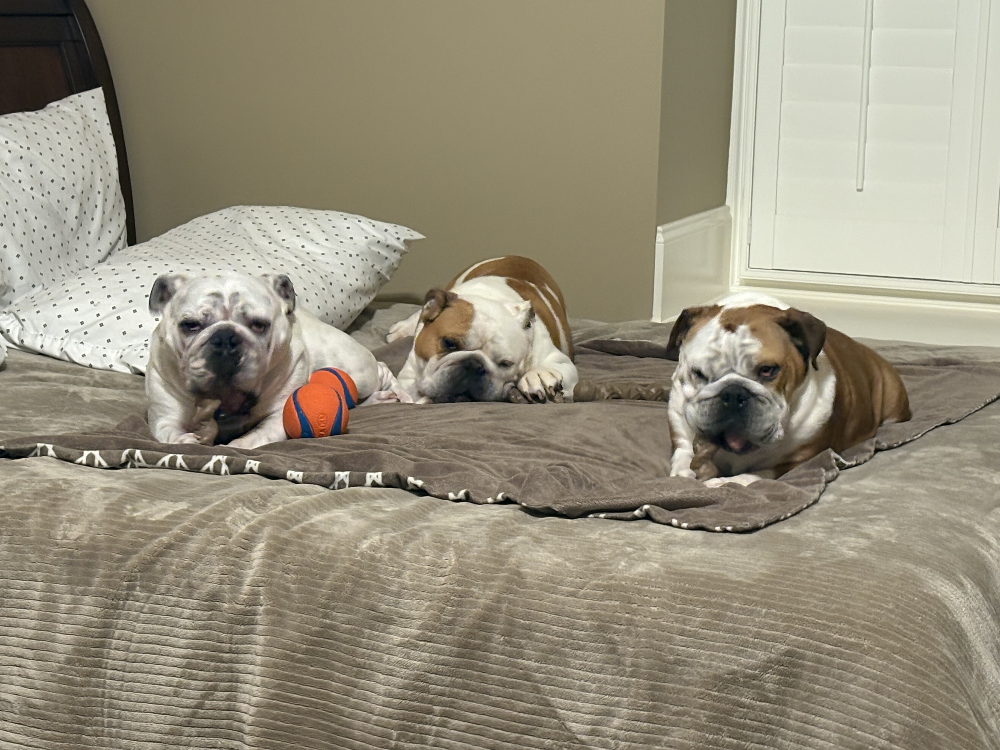

----------------------------------------


In [12]:
search_images("dog with ball")

Match #1
File: IMG_1171.json
Context: 
                Subject: Sleeping dog
                Description: A brown-furred dog is curled up ...


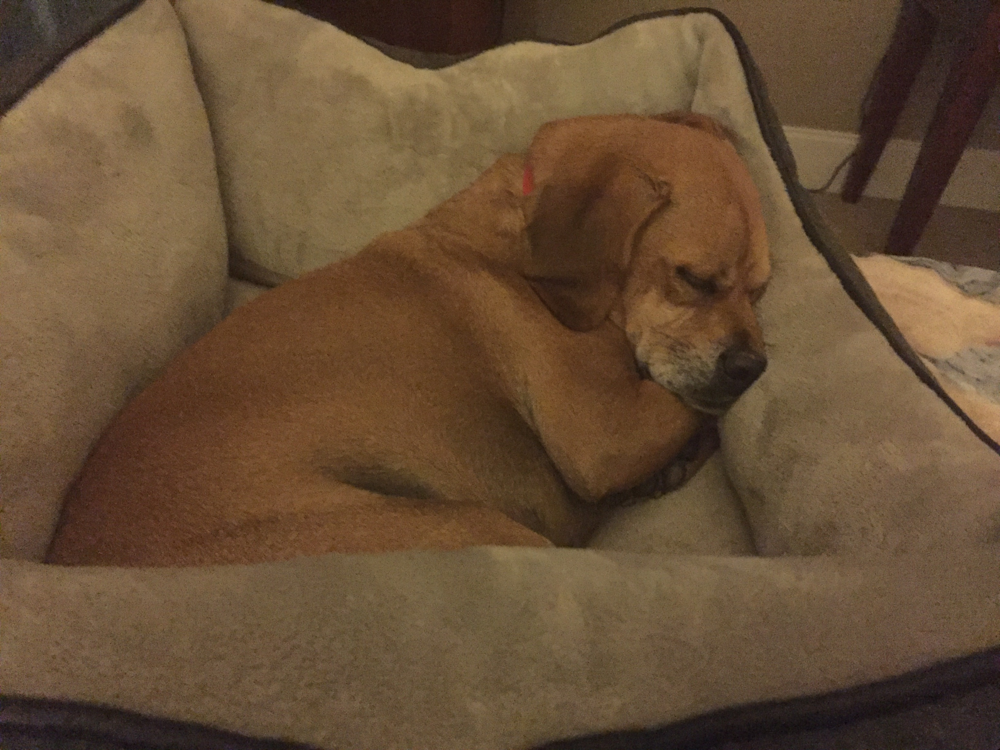

----------------------------------------
Match #2
File: IMG_2045.json
Context: 
                Subject: Brown dog
                Description: A brown dog with floppy ears is cap...


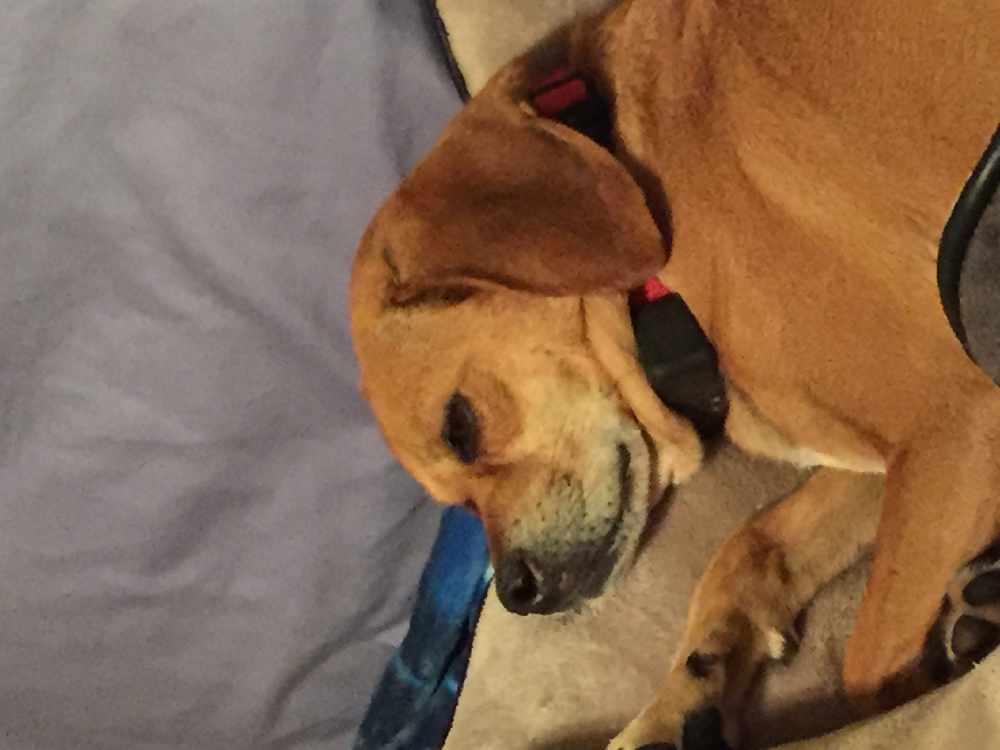

----------------------------------------
Match #3
File: IMG_0041.json
Context: 
                Subject: Two dogs sleeping
                Description: A light-colored Labrador Re...


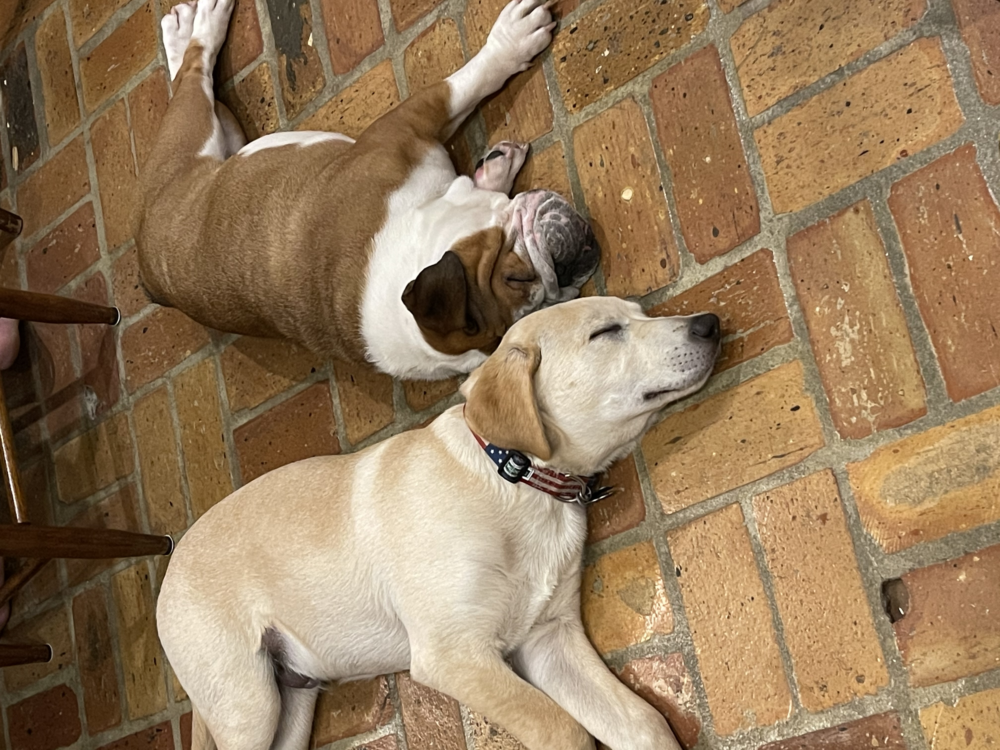

----------------------------------------


In [13]:
search_images("dog sleeping")